In [2]:
# Import the dependencies.
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Use the citipy module to determine city based on latitude and longitude.
from citipy import citipy
from config import weather_api_key

# Import the datetime module from the datetime library.
from datetime import datetime

In [3]:
url = "http://api.openweathermap.org/data/2.5/weather?units=Imperial&APPID=" + weather_api_key
print(url)

http://api.openweathermap.org/data/2.5/weather?units=Imperial&APPID=d4cb209770713b56aa45c40025b8cc28


In [4]:
# Create a set of random latitude and longitude combinations.
lats = np.random.uniform(low=-90.000, high=90.000, size=1500)
lngs = np.random.uniform(low=-180.000, high=180.000, size=1500)
lat_lngs = zip(lats, lngs)
lat_lngs

In [5]:
# Add the latitudes and longitudes to a list.
#coordinates = list(lat_lngs)

In [6]:
x = [25.12903645, 25.92017388, 26.62509167, -59.98969384, 37.30571269]
y = [-67.59741259, 11.09532135, 74.84233102, -76.89176677, -61.13376282]
coordinates = zip(x, y)

In [7]:
from citipy import citipy

# Use the tuple() function to display the latitude and longitude combinations.
for coordinate in coordinates:
    print(citipy.nearest_city(coordinate[0], coordinate[1]).city_name,
          citipy.nearest_city(coordinate[0], coordinate[1]).country_code)

cockburn town tc
gat ly
parvatsar in
punta arenas cl
saint george bm


In [8]:
# Create a list for holding the cities.
cities = []

# Identify the nearest city for each latitude and longitude combination.
for coordinate in lat_lngs:
    city = citipy.nearest_city(coordinate[0], coordinate[1]).city_name

    # If the city is unique, then we will add it to the cities list.
    if city not in cities:
        cities.append(city)

        # Print the city count to confirm sufficient count.
len(cities)

597

In [9]:
import requests 
# Create an empty list to hold the weather data.
city_data = []
# Print the beginning of the logging.
print("Beginning Data Retrieval     ")
print("-----------------------------")

# Create counters.
record_count = 1
set_count = 1

# Loop through all the cities in our list.
for i in range(len(cities)):

    # Group cities in sets of 50 for logging purposes.
    if (i % 50 == 0 and i >= 50):
        set_count += 1
        record_count = 1
    # Create endpoint URL with each city.
    city_url = url + "&q=" + "i"
    
# Loop through all the cities in the list.
for i, city in enumerate(cities):

    # Group cities in sets of 50 for logging purposes.
    if (i % 50 == 0 and i >= 50):
        set_count += 1
        record_count = 1
    # Create endpoint URL with each city.
    city_url = url + "&q=" + city.replace(" ","+")

    # Log the URL, record, and set numbers and the city.
    print(f"Processing Record {record_count} of Set {set_count} | {city}")
    # Add 1 to the record count.
    record_count += 1

# Run an API request for each of the cities.
    try:
        # Parse the JSON and retrieve data.
        city_weather = requests.get(city_url).json()
        # Parse out the needed data.
        city_lat = city_weather["coord"]["lat"]
        city_lng = city_weather["coord"]["lon"]
        city_max_temp = city_weather["main"]["temp_max"]
        city_humidity = city_weather["main"]["humidity"]
        city_clouds = city_weather["clouds"]["all"]
        city_wind = city_weather["wind"]["speed"]
        city_country = city_weather["sys"]["country"]
        # Convert the date to ISO standard.
        city_date = datetime.utcfromtimestamp(city_weather["dt"]).strftime('%Y-%m-%d %H:%M:%S')
        # Append the city information into city_data list.
        city_data.append({"City": city.title(),
                          "Lat": city_lat,
                          "Lng": city_lng,
                          "Max Temp": city_max_temp,
                          "Humidity": city_humidity,
                          "Cloudiness": city_clouds,
                          "Wind Speed": city_wind,
                          "Country": city_country,
                          "Date": city_date})
        print(city_data)
# If an error is experienced, skip the city.
    except KeyError:
        print("City not found. Skipping...")
        pass

# Indicate that Data Loading is complete.
print("-----------------------------")
print("Data Retrieval Complete      ")
print("-----------------------------")

Beginning Data Retrieval     
-----------------------------
Processing Record 1 of Set 12 | luderitz
[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}]
Processing Record 2 of Set 12 | klaksvik
[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}]
Processing Record 3 of Set 12 | touros
[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'C

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

City not found. Skipping...
Processing Record 33 of Set 13 | bereznik
[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Hu

City not found. Skipping...
Processing Record 36 of Set 13 | kapaa
[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humid

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

City not found. Skipping...
Processing Record 42 of Set 13 | mys shmidta
City not found. Skipping...
Processing Record 43 of Set 13 | ellisras
[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'Ci

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

City not found. Skipping...
Processing Record 9 of Set 14 | chipiona
[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Hum

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

City not found. Skipping...
Processing Record 17 of Set 14 | lakselv
[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Hum

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

City not found. Skipping...
Processing Record 22 of Set 14 | port blair
[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, '

City not found. Skipping...
Processing Record 24 of Set 14 | brae
[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidi

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

City not found. Skipping...
Processing Record 30 of Set 14 | inuvik
[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humi

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

City not found. Skipping...
Processing Record 43 of Set 14 | alta floresta
[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

City not found. Skipping...
Processing Record 18 of Set 15 | nanakuli
[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Hu

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

City not found. Skipping...
Processing Record 42 of Set 15 | shadegan
[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Hu

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

City not found. Skipping...
Processing Record 19 of Set 16 | isla mujeres
[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8,

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

City not found. Skipping...
Processing Record 40 of Set 16 | sao filipe
[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

City not found. Skipping...
Processing Record 23 of Set 18 | fuerte
[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humi

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

City not found. Skipping...
Processing Record 6 of Set 19 | kokoda
[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humid

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

City not found. Skipping...
Processing Record 47 of Set 19 | lixourion
[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'H

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

City not found. Skipping...
Processing Record 24 of Set 20 | tynda
[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humid

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

City not found. Skipping...
Processing Record 18 of Set 22 | sakakah
[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Hum

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

City not found. Skipping...
Processing Record 28 of Set 22 | grand centre
City not found. Skipping...
Processing Record 29 of Set 22 | zolotinka
City not found. Skipping...
Processing Record 30 of Set 22 | ca mau
[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wi

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

City not found. Skipping...
Processing Record 17 of Set 23 | northam
[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Hum

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

[{'City': 'Luderitz', 'Lat': -26.65, 'Lng': 15.16, 'Max Temp': 68.65, 'Humidity': 42, 'Cloudiness': 32, 'Wind Speed': 25.41, 'Country': 'NA', 'Date': '2020-10-31 18:13:02'}, {'City': 'Klaksvik', 'Lat': 62.23, 'Lng': -6.59, 'Max Temp': 51.8, 'Humidity': 93, 'Cloudiness': 100, 'Wind Speed': 21.92, 'Country': 'FO', 'Date': '2020-10-31 18:13:03'}, {'City': 'Touros', 'Lat': -5.2, 'Lng': -35.46, 'Max Temp': 86, 'Humidity': 66, 'Cloudiness': 75, 'Wind Speed': 16.11, 'Country': 'BR', 'Date': '2020-10-31 18:13:03'}, {'City': 'Ushuaia', 'Lat': -54.8, 'Lng': -68.3, 'Max Temp': 55.4, 'Humidity': 58, 'Cloudiness': 75, 'Wind Speed': 5.82, 'Country': 'AR', 'Date': '2020-10-31 18:13:03'}, {'City': 'La Ronge', 'Lat': 55.1, 'Lng': -105.28, 'Max Temp': 19.4, 'Humidity': 79, 'Cloudiness': 99, 'Wind Speed': 8.05, 'Country': 'CA', 'Date': '2020-10-31 18:13:03'}, {'City': 'Mount Gambier', 'Lat': -37.83, 'Lng': 140.77, 'Max Temp': 42.8, 'Humidity': 100, 'Cloudiness': 90, 'Wind Speed': 1.12, 'Country': 'AU', '

In [10]:
# Convert the array of dictionaries to a Pandas DataFrame.
city_data_df = pd.DataFrame(city_data)
city_data_df.head(10)

,City,Lat,Lng,Max Temp,Humidity,Cloudiness,Wind Speed,Country,Date
0,Luderitz,-26.65,15.16,68.65,42,32,25.41,NA,2020-10-31 18:13:02
1,Klaksvik,62.23,-6.59,51.80,93,100,21.92,FO,2020-10-31 18:13:03
2,Touros,-5.20,-35.46,86.00,66,75,16.11,BR,2020-10-31 18:13:03
3,Ushuaia,-54.80,-68.30,55.40,58,75,5.82,AR,2020-10-31 18:13:03
4,La Ronge,55.10,-105.28,19.40,79,99,8.05,CA,2020-10-31 18:13:03
5,Mount Gambier,-37.83,140.77,42.80,100,90,1.12,AU,2020-10-31 18:13:04
6,Yulara,-25.24,130.99,68.00,24,57,5.82,AU,2020-10-31 18:13:04
7,Tasiilaq,65.61,-37.64,33.80,86,75,2.24,GL,2020-10-31 18:13:04
8,Rocha,-34.48,-54.33,63.99,63,1,10.83,UY,2020-10-31 18:12:37
9,Korgen,66.08,13.82,35.01,83,0,4.70,NO,2020-10-31 18:13:04


In [17]:
# Extract relevant fields from the DataFrame for plotting.
lats = city_data_df["Lat"]
max_temps = city_data_df["Max Temp"]
humidity = city_data_df["Humidity"]
cloudiness = city_data_df["Cloudiness"]
wind_speed = city_data_df["Wind Speed"]

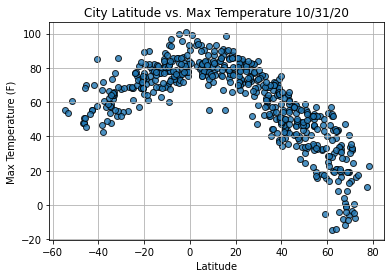

In [23]:
# Build the scatter plot for latitude vs. max temperature.
plt.scatter(lats,
            max_temps,
            edgecolor="black", linewidths=1, marker="o",
            alpha=0.8, label="Cities")

# Incorporate the other graph properties.
plt.title(f"City Latitude vs. Max Temperature "+ time.strftime("%x"))
plt.ylabel("Max Temperature (F)")
plt.xlabel("Latitude")
plt.grid(True)

# Save the figure.
# plt.savefig("/Fig1.png")

# Show plot.
plt.show()

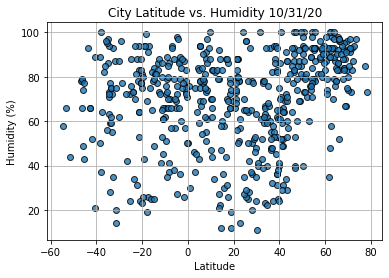

In [24]:
# Build the scatter plots for latitude vs. humidity.
plt.scatter(lats,
            humidity,
            edgecolor="black", linewidths=1, marker="o",
            alpha=0.8, label="Cities")

# Incorporate the other graph properties.
plt.title(f"City Latitude vs. Humidity "+ time.strftime("%x"))
plt.ylabel("Humidity (%)")
plt.xlabel("Latitude")
plt.grid(True)
# Save the figure.
#plt.savefig("weather_data/Fig2.png")
# Show plot.
plt.show()

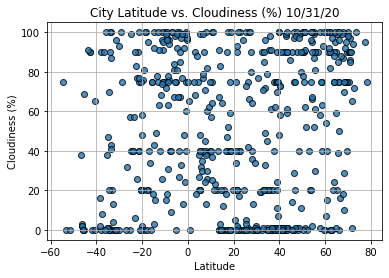

In [25]:
# Build the scatter plots for latitude vs. cloudiness.
plt.scatter(lats,
            cloudiness,
            edgecolor="black", linewidths=1, marker="o",
            alpha=0.8, label="Cities")

# Incorporate the other graph properties.
plt.title(f"City Latitude vs. Cloudiness (%) "+ time.strftime("%x"))
plt.ylabel("Cloudiness (%)")
plt.xlabel("Latitude")
plt.grid(True)
# Save the figure.
#plt.savefig("weather_data/Fig3.png")
# Show plot.
plt.show()

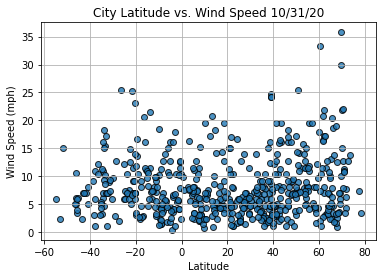

In [26]:
# Build the scatter plots for latitude vs. wind speed.
plt.scatter(lats,
            wind_speed,
            edgecolor="black", linewidths=1, marker="o",
            alpha=0.8, label="Cities")

# Incorporate the other graph properties.
plt.title(f"City Latitude vs. Wind Speed "+ time.strftime("%x"))
plt.ylabel("Wind Speed (mph)")
plt.xlabel("Latitude")
plt.grid(True)
# Save the figure.
#plt.savefig("weather_data/Fig4.png")
# Show plot.
plt.show()